In this example we will train a ML model for prediction of real state prices. We will do a supervised regression and the metric will be mean squared error

In [1]:
import requests
import tarfile
import pandas as pd
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import folium

In [2]:
URL = "https://mymldatasets.s3.eu-de.cloud-object-storage.appdomain.cloud/housing.tgz"
PATH = "housing.tgz"

def getData(url=URL, path=PATH):
  r = requests.get(url)
  with open(path, 'wb') as f:
    f.write(r.content)
  housing_tgz = tarfile.open(path)
  housing_tgz.extractall()
  housing_tgz.close()

In [3]:
getData()

In [2]:


PATH = "housing.csv"

def loadData(path=PATH):
  return pd.read_csv(path)
data = loadData()

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [4]:
data.sample(20)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
18459,-121.80,37.27,10.0,3301.0,593.0,2190.0,575.0,6.2230,260700.0,<1H OCEAN
7804,-118.08,33.89,41.0,834.0,166.0,603.0,179.0,3.7321,167500.0,<1H OCEAN
18208,-122.05,37.39,25.0,347.0,82.0,148.0,77.0,4.4531,350000.0,<1H OCEAN
3023,-119.46,35.17,40.0,4164.0,812.0,1998.0,773.0,2.8323,50800.0,INLAND
1265,-121.71,37.99,27.0,3861.0,718.0,2085.0,707.0,3.3558,129700.0,INLAND
16967,-122.31,37.54,49.0,1340.0,281.0,660.0,284.0,4.1630,393800.0,NEAR OCEAN
11737,-121.08,38.89,41.0,3471.0,753.0,1680.0,710.0,2.6701,139000.0,INLAND
15039,-117.00,32.77,35.0,2114.0,317.0,881.0,320.0,5.5000,241400.0,<1H OCEAN
2122,-119.71,36.74,18.0,8099.0,1670.0,4476.0,1514.0,2.4728,88300.0,INLAND
9867,-121.84,36.61,26.0,2902.0,761.0,2258.0,719.0,2.5663,128900.0,<1H OCEAN


## 1. Divide the data set into train and test

In [3]:
train, test = train_test_split(data, test_size=0.2, random_state=22)

train.to_csv('housing_train.csv', index=False)
test.to_csv('housing_test.csv', index=False)

## 2. EDA

In [4]:
%matplotlib inline
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [7]:
data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [3]:
data['ocean_proximity'].value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

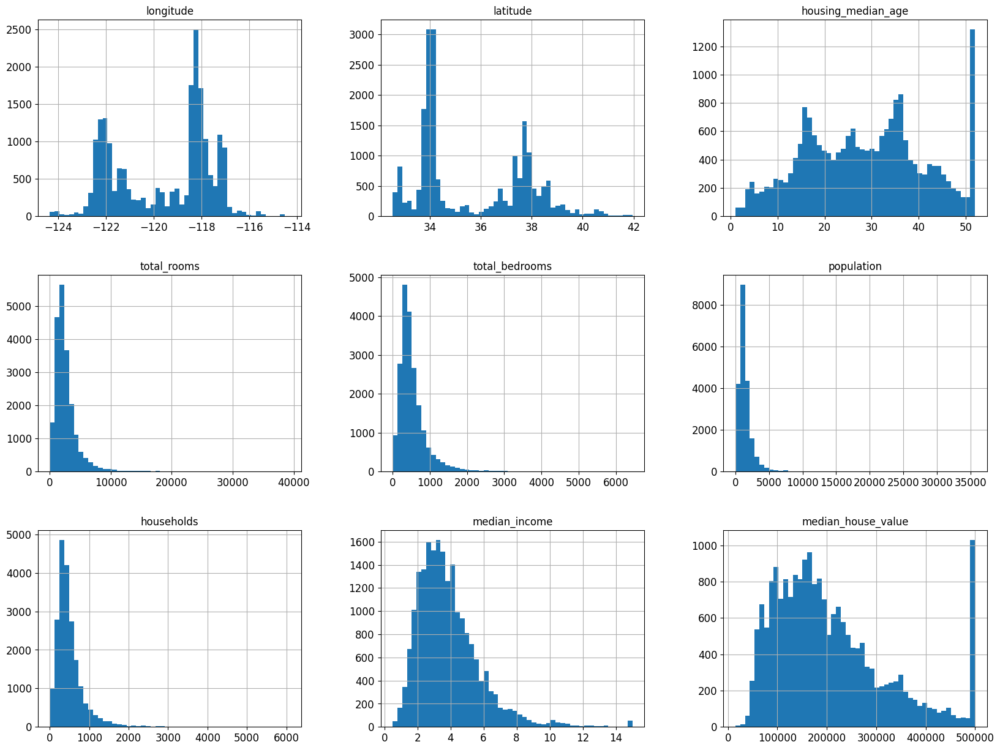

In [10]:
data.hist(bins=50, figsize=(20,15))
plt.show()

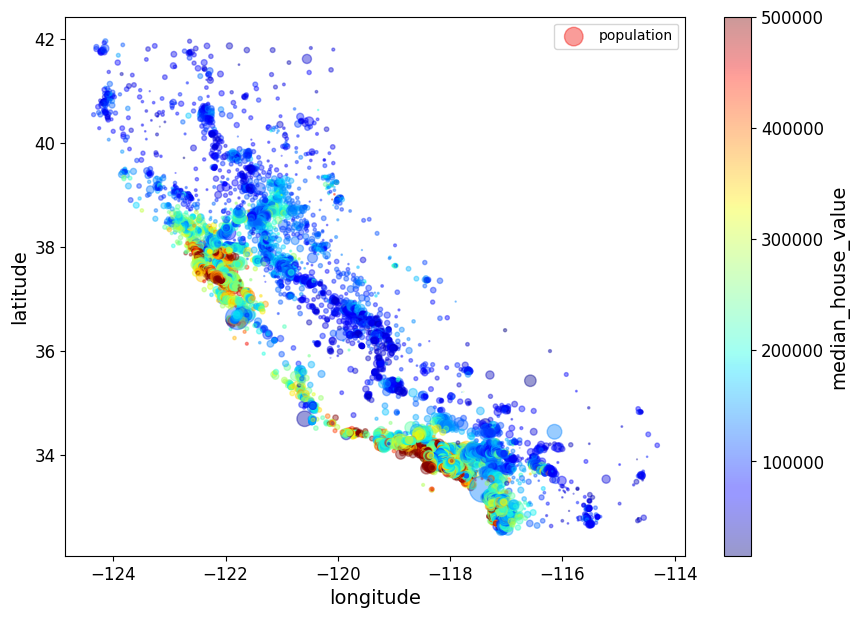

In [11]:
data.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
    s=data["population"]/100, label="population", figsize=(10,7),
    c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True,
    sharex=False)
plt.legend()
plt.show()

In [9]:

from branca.colormap import linear

# Create a colormap
colormap = linear.YlOrRd_09.scale(data['median_house_value'].min(), data['median_house_value'].max())
#colormap = linear.Blues_09.scale(data['median_house_value'].min(), data['median_house_value'].max())

# Create a map centered at a specific location
map_center = [37.7749, -122.4194]  # San Francisco coordinates
my_map = folium.Map(location=map_center, zoom_start=10)

# Iterate through each data point and add a circle marker to the map
for index, row in data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],  # Latitude and longitude of the point
        radius=row['population'] / 700,  # Adjust the radius based on population
        color='None',  # Marker color
        fill=True,
        fill_color=colormap(row['median_house_value']),  # Color based on median_house_value
        fill_opacity=0.9,
        tooltip=row['median_house_value']  # Tooltip to show additional information
    ).add_to(my_map)

# Add colormap to the map
colormap.add_to(my_map)

# Display the map
my_map


In [4]:
numeric_data = data.select_dtypes(include=[np.number])  # Selecting only numeric columns
corr_matrix = numeric_data.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688075
total_rooms           0.134153
housing_median_age    0.105623
households            0.065843
total_bedrooms        0.049686
population           -0.024650
longitude            -0.045967
latitude             -0.144160
Name: median_house_value, dtype: float64

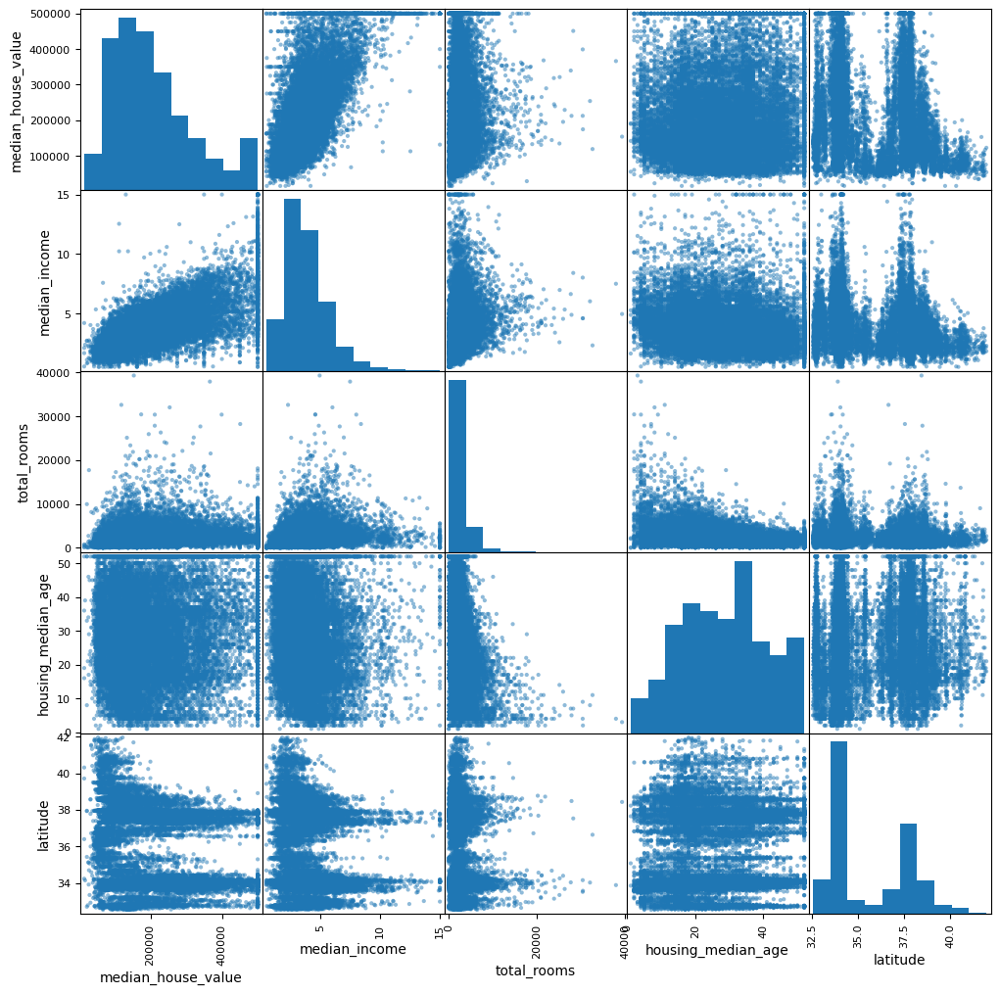

In [5]:
from pandas.plotting import scatter_matrix

attributes = ["median_house_value", "median_income", "total_rooms","housing_median_age", "latitude"]
scatter_matrix(data[attributes], figsize=(12, 12))
plt.show()

In [6]:
data = pd.read_csv('housing_train.csv')
data, labels = data.drop(['median_house_value'], axis=1), data['median_house_value'].copy()  #separate the median_house_value column
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
0,-119.72,36.76,23.0,6403.0,NaN,3573.0,1260.0,2.3006,INLAND
1,-120.79,38.70,13.0,5036.0,1034.0,2243.0,923.0,2.3319,INLAND
2,-118.20,34.04,18.0,796.0,227.0,547.0,218.0,1.0333,<1H OCEAN
3,-117.34,33.21,12.0,5963.0,1372.0,3015.0,1124.0,2.7386,NEAR OCEAN
4,-121.46,38.54,48.0,1001.0,205.0,605.0,175.0,1.8333,INLAND


In [7]:
data_num = data.drop(['ocean_proximity'], axis=1)
data_num.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
0,-119.72,36.76,23.0,6403.0,NaN,3573.0,1260.0,2.3006
1,-120.79,38.70,13.0,5036.0,1034.0,2243.0,923.0,2.3319
2,-118.20,34.04,18.0,796.0,227.0,547.0,218.0,1.0333
3,-117.34,33.21,12.0,5963.0,1372.0,3015.0,1124.0,2.7386
4,-121.46,38.54,48.0,1001.0,205.0,605.0,175.0,1.8333


In [8]:
data_cat = data[['ocean_proximity']]
data_cat.head()

,ocean_proximity
0,INLAND
1,INLAND
2,<1H OCEAN
3,NEAR OCEAN
4,INLAND


In [9]:
data_num.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        163
population              0
households              0
median_income           0
dtype: int64

Complete the nan values

In [10]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")
imputer.fit(data_num)
imputer.statistics_

array([-118.51  ,   34.26  ,   29.    , 2126.    ,  435.    , 1165.    ,
        410.    ,    3.5334])

## 3. Impute values, encode categorical data, normalize and add calculated fields.

In [11]:
# we create a new data frame (data_fr) to which we will impute values to replace NaN
X = imputer.transform(data_num)  
data_tr = pd.DataFrame(X, columns=data_num.columns, index=data.index)
data_tr.isnull().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
dtype: int64

In [12]:
# we have to encode categorical data
from sklearn.preprocessing import OneHotEncoder

cat_encoder = OneHotEncoder()
data_cat_1hot = cat_encoder.fit_transform(data_cat)
data_cat_1hot.toarray()

array([[0., 1., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       ...,
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.],
       [1., 0., 0., 0., 0.]])

In [13]:
# We will add calculated features:

from sklearn.base import BaseEstimator, TransformerMixin

# column index
rooms_ix, bedrooms_ix, population_ix, households_ix = 3, 4, 5, 6

class CombinedAttributesAdder(BaseEstimator, TransformerMixin):
    def __init__(self, add_bedrooms_per_room = True): # no *args or **kargs
        self.add_bedrooms_per_room = add_bedrooms_per_room

    def fit(self, X, y=None):
        return self  # nothing else to do

    def transform(self, X):
        rooms_per_household = X[:, rooms_ix] / X[:, households_ix]
        population_per_household = X[:, population_ix] / X[:, households_ix]
        if self.add_bedrooms_per_room:
            bedrooms_per_room = X[:, bedrooms_ix] / X[:, rooms_ix]
            return np.c_[X, rooms_per_household, population_per_household, bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household]

In [14]:
attr_adder = CombinedAttributesAdder(add_bedrooms_per_room=False)
data_extra_attribs = attr_adder.transform(data.values)
data_extra_attribs.shape # 9 + 2

(16512, 11)

In [15]:
#Standardization ( Normalizacion)

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_num)
data_tr = pd.DataFrame(data_scaled, columns=data_num.columns, index=data.index)
data_tr.describe()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
count,1.651200e+04,1.651200e+04,1.651200e+04,1.651200e+04,1.634900e+04,1.651200e+04,1.651200e+04,1.651200e+04
mean,7.217525e-16,6.491362e-16,1.207583e-16,2.216143e-17,-2.933613e-18,7.627404e-17,4.028862e-17,-6.981926e-17
std,1.000030e+00,1.000030e+00,1.000030e+00,1.000030e+00,1.000031e+00,1.000030e+00,1.000030e+00,1.000030e+00
min,-2.381604e+00,-1.445235e+00,-2.201136e+00,-1.214416e+00,-1.278351e+00,-1.256377e+00,-1.310671e+00,-1.764526e+00
25%,-1.105456e+00,-7.998537e-01,-8.491991e-01,-5.457575e-01,-5.776820e-01,-5.636872e-01,-5.758077e-01,-6.848289e-01
50%,5.324548e-01,-6.455233e-01,2.558386e-02,-2.329159e-01,-2.440301e-01,-2.270859e-01,-2.333984e-01,-1.765975e-01
75%,7.819462e-01,9.679302e-01,6.617896e-01,2.338048e-01,2.564478e-01,2.609859e-01,2.723138e-01,4.571083e-01
max,2.628182e+00,2.950841e+00,1.854675e+00,1.631534e+01,1.407917e+01,3.034782e+01,1.470618e+01,5.825810e+00


## 4. Pipeline.
We will put the previous steps into a pipeline

In [16]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

num_attribs = list(data_num)
cat_attribs = ["ocean_proximity"]

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('attribs_adder', CombinedAttributesAdder()),
        ('std_scaler', StandardScaler()),
    ])

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])

data_prepared = full_pipeline.fit_transform(data)
data_prepared.shape # 8 numericas + 3 adicionales + 5 categoricas one hot encoded

(16512, 16)

In [15]:
data_prepared

array([[-0.07131414,  0.52364592, -0.45157048, ...,  0.        ,
         0.        ,  0.        ],
       [-0.60522556,  1.43092125, -1.2468277 , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.68713946, -0.74841021, -0.84919909, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [-1.32875038,  1.16902734, -1.08777626, ...,  0.        ,
         1.        ,  0.        ],
       [-1.43353673,  0.96793023,  0.97989253, ...,  0.        ,
         0.        ,  1.        ],
       [ 0.83184442, -0.84194375,  0.50273819, ...,  0.        ,
         0.        ,  0.        ]])

## 5. Model testing. 
Now we test different models and we will compare the RMSE value choosing the lowest one

In [17]:
#linear Regression

from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(data_prepared, labels)

LinearRegression()

In [18]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(lin_reg, data_prepared, labels, scoring="neg_mean_squared_error", cv=10)
lin_rmse_scores = np.sqrt(-scores)

In [19]:
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

display_scores(lin_rmse_scores)

Scores: [66437.86587554 67017.05947527 68432.15315087 72976.84720006
 71744.30539608 68479.63555331 69612.83771288 69513.25260389
 70670.12226447 66708.70099048]
Mean: 69159.27802228527
Standard deviation: 2070.2898903422656


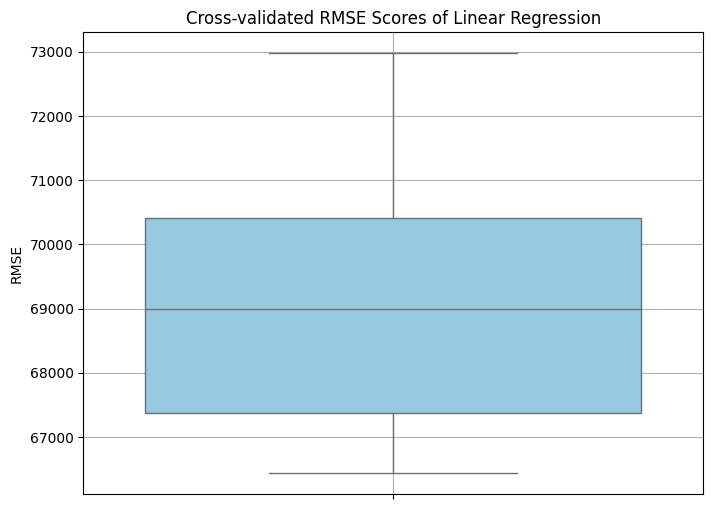

In [46]:
import seaborn as sns

# Assuming you have a function named display_scores for displaying scores
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

# Plotting the RMSE scores
plt.figure(figsize=(8, 6))
sns.boxplot(lin_rmse_scores, color='skyblue')
plt.title('Cross-validated RMSE Scores of Linear Regression')
plt.ylabel('RMSE')
plt.grid(True)
plt.show()

In [20]:
#DecisionTreeRegressor

from sklearn.tree import DecisionTreeRegressor

tree_reg = DecisionTreeRegressor(random_state=42)
tree_reg.fit(data_prepared, labels)

DecisionTreeRegressor(random_state=42)

In [21]:
scores = cross_val_score(tree_reg, data_prepared, labels, scoring="neg_mean_squared_error", cv=10)
tree_rmse_scores = np.sqrt(-scores)
display_scores(tree_rmse_scores)

Scores: [68703.4303478  72987.81742712 71233.51615824 70066.66438864
 72373.81760126 68460.05433753 70375.70934853 70646.82923159
 72878.96434678 72629.31645032]
Mean: 71035.61196378153
Standard deviation: 1586.7249169822012


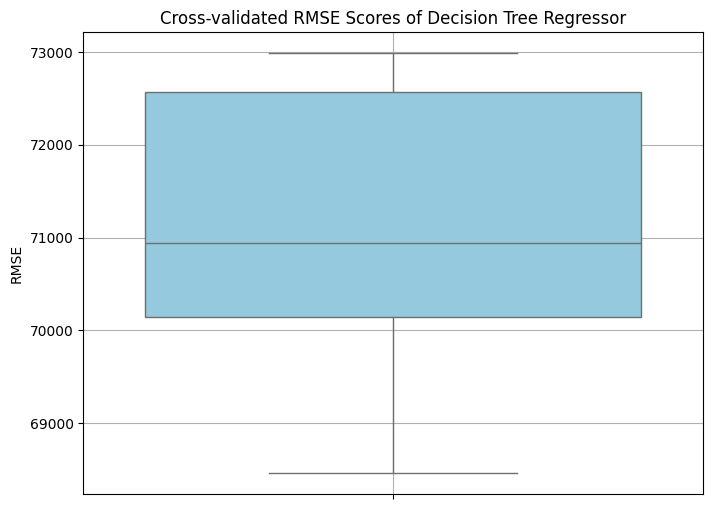

In [45]:
import seaborn as sns

# Assuming you have a function named display_scores for displaying scores
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

# Plotting the RMSE scores
plt.figure(figsize=(8, 6))
sns.boxplot(tree_rmse_scores, color='skyblue')
plt.title('Cross-validated RMSE Scores of Decision Tree Regressor')
plt.ylabel('RMSE')
plt.grid(True)
plt.show()

In [23]:
# Random Forest Regressor

from sklearn.ensemble import RandomForestRegressor

forest_reg = RandomForestRegressor(random_state=42)
forest_reg.fit(data_prepared, labels)


RandomForestRegressor(random_state=42)

In [24]:
forest_scores = cross_val_score(forest_reg, data_prepared, labels, scoring="neg_mean_squared_error", cv=10)
forest_rmse_scores = np.sqrt(-forest_scores)
display_scores(forest_rmse_scores)

Scores: [45637.58713947 49631.22910104 50519.55905349 50609.95649911
 51309.02977016 50889.62631257 51532.353351   52301.92975819
 51709.06028876 48820.41504381]
Mean: 50296.074631759584
Standard deviation: 1827.4658318410761


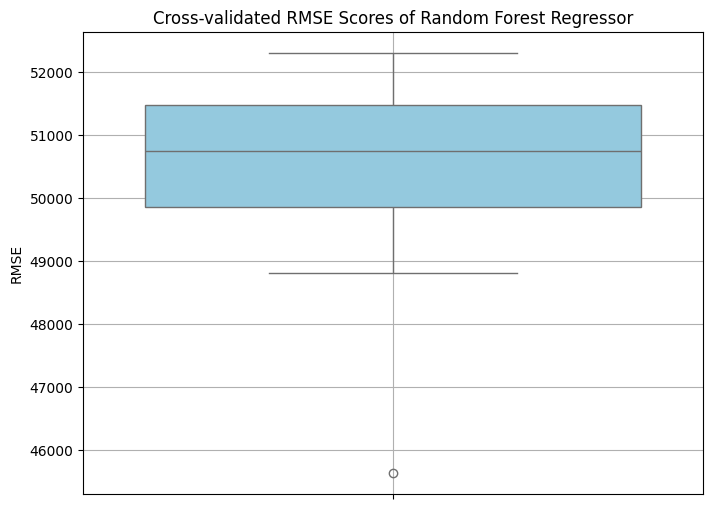

In [41]:
import seaborn as sns

# Assuming you have a function named display_scores for displaying scores
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

# Plotting the RMSE scores
plt.figure(figsize=(8, 6))
sns.boxplot(forest_rmse_scores, color='skyblue')
plt.title('Cross-validated RMSE Scores of Random Forest Regressor')
plt.ylabel('RMSE')
plt.grid(True)
plt.show()

##  6. Model adjust

In [25]:
# Finding the best hyperparameters for random forest

from sklearn.model_selection import GridSearchCV

param_grid = [
    # try 12 (3×4) combinations of hyperparameters
    {'n_estimators': [3, 10, 30], 'max_features': [2, 4, 6, 8]},
    # then try 6 (2×3) combinations with bootstrap set as False
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
  ]

forest_reg = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(forest_reg, param_grid, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=-1)
grid_search.fit(data_prepared, labels)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [26]:
GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [27]:
grid_search.best_params_

{'max_features': 8, 'n_estimators': 30}

In [28]:
grid_search.best_estimator_

RandomForestRegressor(max_features=8, n_estimators=30, random_state=42)

In [29]:
RandomForestRegressor(max_features=8, n_estimators=30, random_state=42)

RandomForestRegressor(max_features=8, n_estimators=30, random_state=42)

In [30]:

#generate RMSE with different parameters
cvres = grid_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

63665.78629364774 {'max_features': 2, 'n_estimators': 3}
55306.96792983332 {'max_features': 2, 'n_estimators': 10}
52600.84680610766 {'max_features': 2, 'n_estimators': 30}
59101.51992683164 {'max_features': 4, 'n_estimators': 3}
52169.30264246198 {'max_features': 4, 'n_estimators': 10}
50129.76430891404 {'max_features': 4, 'n_estimators': 30}
59183.79980031041 {'max_features': 6, 'n_estimators': 3}
51895.62634200346 {'max_features': 6, 'n_estimators': 10}
50123.53914377234 {'max_features': 6, 'n_estimators': 30}
58509.63670843865 {'max_features': 8, 'n_estimators': 3}
52133.699413921495 {'max_features': 8, 'n_estimators': 10}
49993.671954016354 {'max_features': 8, 'n_estimators': 30}
62965.42237911761 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
54490.029467187705 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
58989.283381114365 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
52452.74210883823 {'bootstrap': False, 'max_features': 3, 'n_estimators'

Calculate the feature importance scores and its corresponding attribute name.

In [31]:
feature_importances = grid_search.best_estimator_.feature_importances_
extra_attribs = ["rooms_per_hhold", "pop_per_hhold", "bedrooms_per_room"]
cat_encoder = full_pipeline.named_transformers_["cat"]
cat_one_hot_attribs = list(cat_encoder.categories_[0])
attributes = num_attribs + extra_attribs + cat_one_hot_attribs
sorted(zip(feature_importances, attributes), reverse=True)

[(0.37482935360484515, 'median_income'),
 (0.16387371587886643, 'INLAND'),
 (0.10502386905150322, 'pop_per_hhold'),
 (0.07093785404419044, 'longitude'),
 (0.06713446676533483, 'latitude'),
 (0.05812976455964789, 'rooms_per_hhold'),
 (0.04685501974832575, 'bedrooms_per_room'),
 (0.04163049058980691, 'housing_median_age'),
 (0.01535439911128857, 'population'),
 (0.015352340773187024, 'total_rooms'),
 (0.014657457859978879, 'total_bedrooms'),
 (0.014002265515751542, 'households'),
 (0.0060152304026969755, '<1H OCEAN'),
 (0.0039028565155283124, 'NEAR OCEAN'),
 (0.0021768791153720856, 'NEAR BAY'),
 (0.00012403646367597324, 'ISLAND')]

## 7. Model testing
Finally we test the model with the best parameters using the test dataset

In [32]:
from sklearn.metrics import mean_squared_error

test_data = pd.read_csv('housing_test.csv')

final_model = grid_search.best_estimator_

X_test = test_data.drop("median_house_value", axis=1)
y_test = test_data["median_house_value"].copy()

X_test_prepared = full_pipeline.transform(X_test)
final_predictions = final_model.predict(X_test_prepared)

final_mse = mean_squared_error(y_test, final_predictions)
final_rmse = np.sqrt(final_mse)

final_rmse

48230.8525852065

Calculate the interval in which the RMSE will likely be considering 0.95 as confidence level.

In [33]:
from scipy import stats

confidence = 0.95
squared_errors = (final_predictions - y_test) ** 2
np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
                         loc=squared_errors.mean(),
                         scale=stats.sem(squared_errors)))

array([46125.79814736, 50247.79624482])

## 8. Deployment
We will export the model and the pipeline so we can use it later.

In [34]:
import joblib

joblib.dump(final_model, "my_model.pkl")
joblib.dump(full_pipeline, "my_pipeline.pkl")

['my_pipeline.pkl']

We will use the save model to make a prediction.

In [35]:
model = joblib.load("my_model.pkl")
pipeline = joblib.load("my_pipeline.pkl")

In [36]:
data_test = sample = pd.read_csv("housing_test.csv")

In [37]:
sample = data_test.sample(3)
sample

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
3515,-121.36,38.03,7.0,3461.0,859.0,1518.0,741.0,3.5684,78700.0,INLAND
1555,-119.78,36.76,50.0,1343.0,322.0,1063.0,342.0,1.7500,49800.0,INLAND
3507,-117.23,34.12,18.0,1439.0,319.0,699.0,310.0,2.1071,73500.0,INLAND


In [38]:
X_test_prepared = pipeline.transform(sample)
final_predictions = model.predict(X_test_prepared)
final_predictions

array([143220.,  55800.,  84390.])